In [3]:
#Import of necessary packages and memory allocation.
!nvidia-smi
%matplotlib inline
import tensorflow as tf
from tensorflow import keras 
from keras import backend as K
#from keras.backend.tensorflow_backend import set_session

import h5py as h5
import pandas as pd
from keras.models import load_model
import numpy as np 
import matplotlib 
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import sys
import seaborn as sns
import cartopy.crs as ccrs
import cartopy.util
s = np.random.seed(1)

Mon May 16 13:25:34 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.60.02    Driver Version: 510.60.02    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  Off  | 00000000:06:00.0  On |                  N/A |
|  0%   47C    P8    17W / 220W |    706MiB /  8192MiB |      3%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [4]:
#Plot parameters.

sns.set() #Seaborn theme 

from matplotlib import rc
font = {'family' : 'normal','weight' : 'bold', 'size'   : 22}
tick_size = 20
fontweight = 'bold'
#lab_loc = 2
#lab_font_size = 14
#rc('text', usetex=True)
matplotlib.rc('font', **font)
plt.style.use('seaborn')

In [8]:
data_folder = '../data/raw/'
model_path = '../model/RESNET_V8_82l_continue4_generator.h5'

In [9]:
#########
multi_train = True  #If the training was in multiple run : True
plot_var = True     #True: plot all cells result ; False : manualy change if plot_var in if True: to plot
save = False         
scale = False
#########
N_fields = 82      #Number of fields == Number of channels in generated tensor. 
N_lvls = 10         #Number of pressure level for 3D variable. 

N_gen = 800      #Number of generation used for statistic analysis /!\ Memory usage important /!\
N_train = 800
#indxs = np.random.randint(0,1000,N_gen)
#ind = indxs[0]
#########
lons = np.genfromtxt(f'../data/raw/lon.csv', delimiter=',')
lat = np.genfromtxt(f'../data/raw/lat.csv', delimiter=',')

print(lons)
lon_idx = [16,16,32,48]                    #France, north america, ecuador, south america
lat_idx = [5,106,106,106]                  #France, north america, ecuador, south america
fnes = [[16,5],[16,106],[32,106],[48,106]] #Coordinate for distribution comparison at different locations.
L_ind = ['a','b','c','d']


a=ord('a')
alph=[chr(i) for i in range(a,a+26)]
print(alph)




[  0.       2.8125   5.625    8.4375  11.25    14.0625  16.875   19.6875
  22.5     25.3125  28.125   30.9375  33.75    36.5625  39.375   42.1875
  45.      47.8125  50.625   53.4375  56.25    59.0625  61.875   64.6875
  67.5     70.3125  73.125   75.9375  78.75    81.5625  84.375   87.1875
  90.      92.8125  95.625   98.4375 101.25   104.0625 106.875  109.6875
 112.5    115.3125 118.125  120.9375 123.75   126.5625 129.375  132.1875
 135.     137.8125 140.625  143.4375 146.25   149.0625 151.875  154.6875
 157.5    160.3125 163.125  165.9375 168.75   171.5625 174.375  177.1875
 180.     182.8125 185.625  188.4375 191.25   194.0625 196.875  199.6875
 202.5    205.3125 208.125  210.9375 213.75   216.5625 219.375  222.1875
 225.     227.8125 230.625  233.4375 236.25   239.0625 241.875  244.6875
 247.5    250.3125 253.125  255.9375 258.75   261.5625 264.375  267.1875
 270.     272.8125 275.625  278.4375 281.25   284.0625 286.875  289.6875
 292.5    295.3125 298.125  300.9375 303.75   306.5

In [10]:
#Loading dataset and scaling factors (N_fields, 2)= mean and variance for each channel.
if N_fields==82:
    f=h5.File(f'{data_folder}data_plasim_50.nc','r')
    _X_train = f['dataset']
    scaling = np.transpose(f['scaling'])

print(scaling.shape)

OSError: Unable to open file (file signature not found)

In [13]:
if N_fields==82:
    var = ['ta', 'ua', 'va', 'hus', 'wap', 'zeta', 'd', 'zg']
    lvls = [100, 200,300,400,500,600,700,800,900,1000]
elif N_fields==22:
    var = ['ta', 'ua', 'va', 'wa', 'pl','lat']
    lvls = [200,500,700,850,1000]


chan_titles = []
for i in var:
    for j in lvls:
        chan_titles.append(i+'_z'+str(j))
chan_titles.append('surface pressure')
#chan_titles.append('latitude')

print(chan_titles)

['ta_z100', 'ta_z200', 'ta_z300', 'ta_z400', 'ta_z500', 'ta_z600', 'ta_z700', 'ta_z800', 'ta_z900', 'ta_z1000', 'ua_z100', 'ua_z200', 'ua_z300', 'ua_z400', 'ua_z500', 'ua_z600', 'ua_z700', 'ua_z800', 'ua_z900', 'ua_z1000', 'va_z100', 'va_z200', 'va_z300', 'va_z400', 'va_z500', 'va_z600', 'va_z700', 'va_z800', 'va_z900', 'va_z1000', 'hus_z100', 'hus_z200', 'hus_z300', 'hus_z400', 'hus_z500', 'hus_z600', 'hus_z700', 'hus_z800', 'hus_z900', 'hus_z1000', 'wap_z100', 'wap_z200', 'wap_z300', 'wap_z400', 'wap_z500', 'wap_z600', 'wap_z700', 'wap_z800', 'wap_z900', 'wap_z1000', 'zeta_z100', 'zeta_z200', 'zeta_z300', 'zeta_z400', 'zeta_z500', 'zeta_z600', 'zeta_z700', 'zeta_z800', 'zeta_z900', 'zeta_z1000', 'd_z100', 'd_z200', 'd_z300', 'd_z400', 'd_z500', 'd_z600', 'd_z700', 'd_z800', 'd_z900', 'd_z1000', 'zg_z100', 'zg_z200', 'zg_z300', 'zg_z400', 'zg_z500', 'zg_z600', 'zg_z700', 'zg_z800', 'zg_z900', 'zg_z1000', 'surface pressure']


In [14]:
sys.path.append('../src/modeling')

sys.path.append('../src/preprocessing')

sys.path.append('../src/preparation')
from SpectralNormalizationKeras import *
from custom_classes import *
from data_preproc import *


gen = load_model(f'{model_path}',custom_objects = {'NearestPadding2D': NearestPadding2D,'WrapPadding2D': WrapPadding2D, 'DenseSN' :DenseSN, 'ConvSN2D': ConvSN2D})

print('Generating samples...')

z = np.random.normal(0,1,(N_gen,64))
fk_imgs = gen.predict(z)
print('Samples generated.')
print('scaling...')
fk_imgs = np.multiply(fk_imgs[:,:,:,:-1],
                    scaling[np.newaxis,:,1]) + scaling[np.newaxis,:,0]
print('scaled.')
print('Database loading...')

if N_fields==82:
    f=h5.File(f'{data_folder}T42_plasim_100y_10lay_scaled.h5','r')
    _X_train = f['dataset']
    scaling = np.transpose(f['scaling'])

print('Database loaded.')
print('Scaling...')
X_train = np.multiply(_X_train[:N_train,:,:,:],
                    scaling[np.newaxis,:,1]) + scaling[np.newaxis,:,0]
print('Scaled')

noise_ = np.load('../data/raw/noise_.npy')
im = gen.predict(noise_)
im_sc = np.multiply(im[:,:,:,:-1],
                    scaling[np.newaxis,:,1]) + scaling[np.newaxis,:,0]
X_train, lon = cartopy.util.add_cyclic_point(X_train, coord=lons, axis=2)
fk_imgs, lon = cartopy.util.add_cyclic_point(fk_imgs, coord=lons, axis=2)
im, lon = cartopy.util.add_cyclic_point(im, coord=lons, axis=2)
im_sc, lon = cartopy.util.add_cyclic_point(im_sc, coord=lons, axis=2)



/softs/anaconda3/envs/tf1.12-cuda10-py36/lib/python3.6/site-packages/keras/engine/saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


Generating samples...
Samples generated.
scaling...
scaled.
Database loading...
Database loaded.
Scaling...
Scaled


In [16]:
#cri.summary()

In [24]:
def zonalPlot(im, N_lvls = N_lvls, title = None):
    im1 = np.mean(im[:,:,0*N_lvls:0*N_lvls+N_lvls], axis = (1))
    
    fig, ax = plt.subplots(2,1, figsize=(10,10))
    fig.subplots_adjust( wspace = 0.35, hspace = 0.3)
    plt.suptitle(title, fontweight = fontweight)
    ax = plt.subplot(211)
    plt.contourf(lat[::],lvls,np.transpose(im1[:,::]), cmap = 'rocket')
    plt.colorbar()
    plt.title('Temperature zonal', fontsize = 20, fontweight = fontweight)
    plt.ylabel('pressure level', fontsize = 20, fontweight = fontweight)
    plt.xlabel('Latitudes', fontsize = 20, fontweight = fontweight)
    plt.yticks(lvls[::-1], fontsize = 15)
    plt.xticks( fontsize = 15)
    ax.set_ylim(1000,200)
    
    im2 = np.mean(im[:,:,1*N_lvls:1*N_lvls+N_lvls], axis = (1))
    ax = plt.subplot(212)
    plt.contourf(lat[::],lvls,np.transpose(im2[:,::]), cmap = 'mako')
    plt.colorbar()
    plt.title('Eastward wind zonal', fontsize = 20, fontweight = fontweight)
    
    plt.ylabel('pressure level', fontsize = 20, fontweight = fontweight)
    plt.xlabel('Latitudes', fontsize = 20, fontweight = fontweight)
    plt.yticks(lvls[::-1], fontsize = 15)
    plt.xticks( fontsize = 15)
    ax.set_ylim(1000,200)
    if save:
        plt.savefig(f'./fig_82c/{title}.pdf')
    return


In [25]:
from matplotlib import animation
from IPython.display import HTML

cnt = 0

(1, 64, 129, 81)


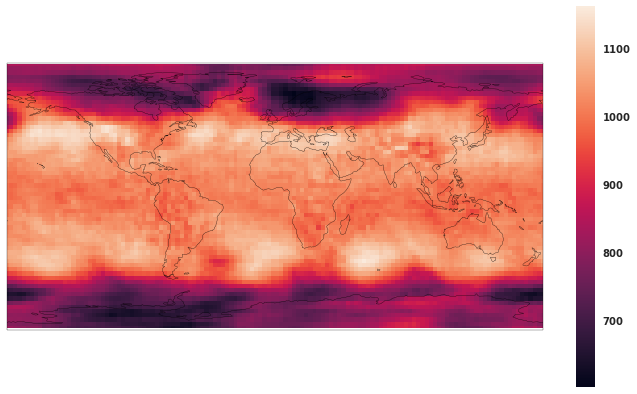

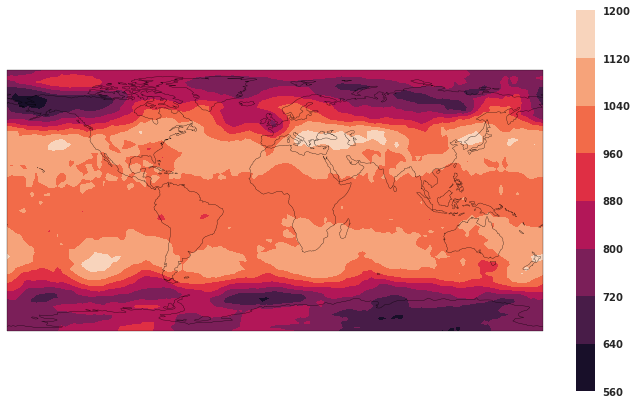

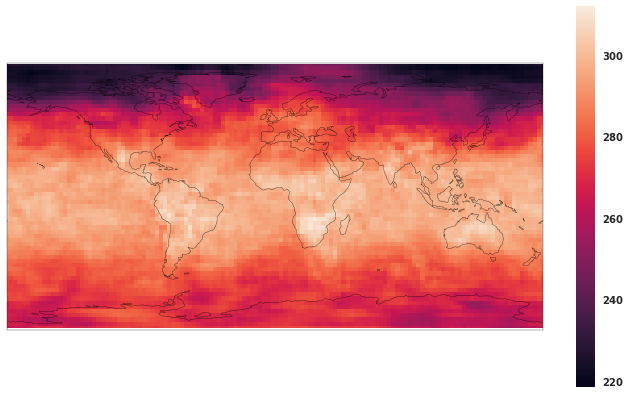

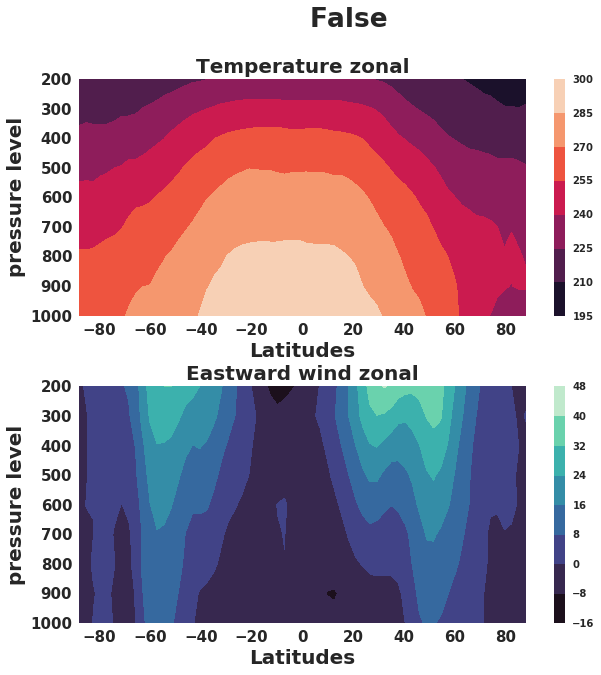

In [26]:
var2plot = -3

#noise_ = np.random.normal(0,1,(1,64))
noise_ = np.load(f'../data/raw/noise_.npy')
img = gen.predict(noise_)
img_s = np.multiply(img[0:1,:,:,:-1],
                    scaling[:,1]) + scaling[:,0]

import cartopy.util
#lons=lon
img_s, lon = cartopy.util.add_cyclic_point(img_s, coord=lons, axis=2)
#plt.imshow()
print(img_s.shape)
plt.figure(figsize=(12,7))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
ax.coastlines()
plt.imshow(img_s[0,:,:,var2plot], cmap = 'rocket', transform = ccrs.PlateCarree(central_longitude=180.))
plt.colorbar()
plt.grid(False)

plt.figure(figsize=(12,7))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
ax.coastlines()

#ax.set_extent([img_s.min(), img_s.max(), img_s.min(), img_s.max()], crs=ccrs.PlateCarree(central_longitude=180.))
plt.contourf(lon, lat, img_s[0,:,:,var2plot], cmap = 'rocket', transform = ccrs.PlateCarree(central_longitude=180.))
plt.colorbar()

plt.figure(figsize=(12,7))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
ax.coastlines()
plt.imshow(img_s[0,:,:,9], cmap = 'rocket', transform = ccrs.PlateCarree(central_longitude=180.))
plt.colorbar()


zonalPlot(img_s[0,:,:,:], N_lvls = N_lvls, title=False)

(1, 64, 129, 81)


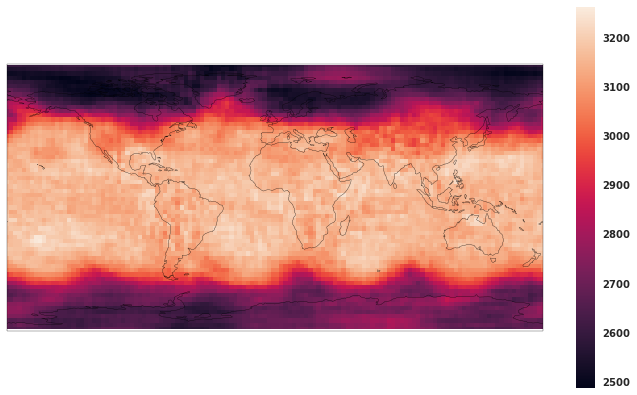

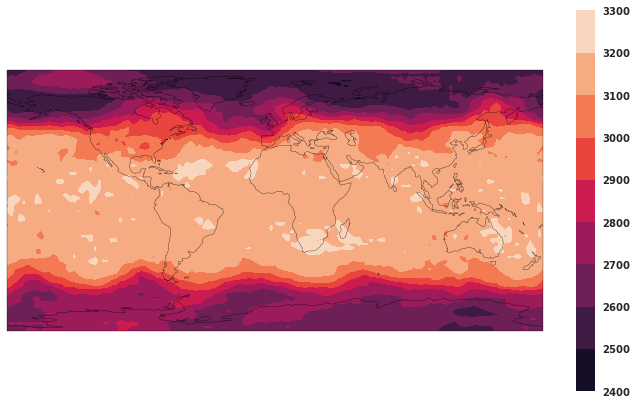

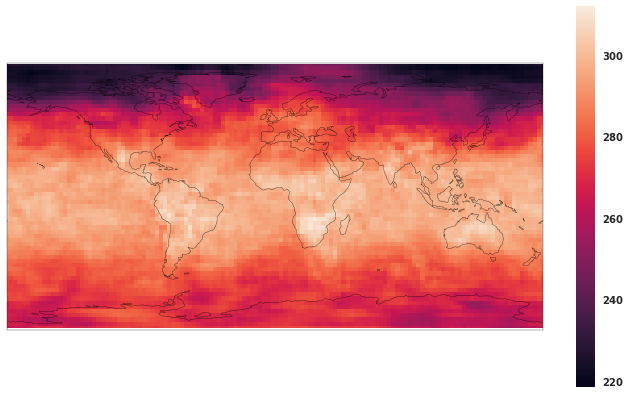

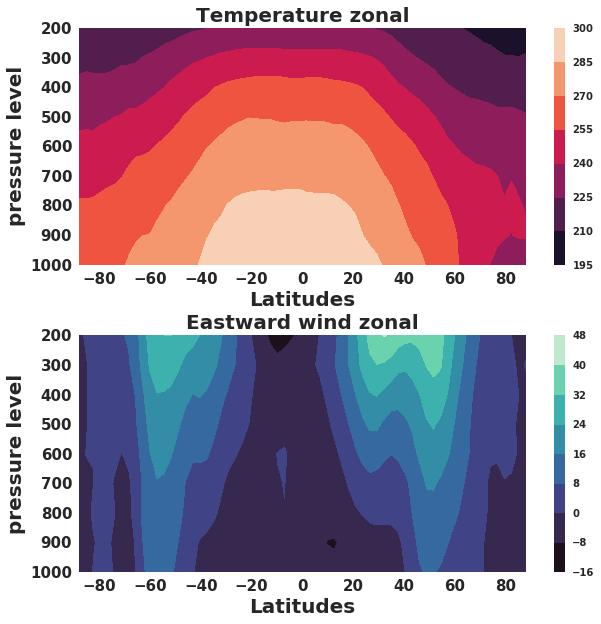

In [28]:
var2plot = -5

#noise2_ = np.random.normal(0,1,(1,64))
noise2_ = np.load('../data/raw/noise_.npy')
img = gen.predict(noise2_)
img_s = np.multiply(img[0:1,:,:,:-1],
                    scaling[:,1]) + scaling[:,0]

import cartopy.util
#lons=lon
img_s, lon = cartopy.util.add_cyclic_point(img_s, coord=lons, axis=2)
#plt.imshow()
print(img_s.shape)
plt.figure(figsize=(12,7))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
ax.coastlines()
plt.imshow(img_s[0,:,:,var2plot], cmap = 'rocket', transform = ccrs.PlateCarree(central_longitude=180.))
plt.colorbar()
plt.grid(False)

plt.figure(figsize=(12,7))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
ax.coastlines()

#ax.set_extent([img_s.min(), img_s.max(), img_s.min(), img_s.max()], crs=ccrs.PlateCarree(central_longitude=180.))
plt.contourf(lon, lat, img_s[0,:,:,var2plot], cmap = 'rocket', transform = ccrs.PlateCarree(central_longitude=180.))
plt.colorbar()

plt.figure(figsize=(12,7))
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
ax.coastlines()
plt.imshow(img_s[0,:,:,9], cmap = 'rocket', transform = ccrs.PlateCarree(central_longitude=180.))
plt.colorbar()


zonalPlot(img_s[0,:,:,:], N_lvls = N_lvls)

In [29]:
#np.save('./fig_82c/noise_', noise_)
#np.save('./fig_82c/noise2_', noise2_)

In [30]:
def interpolation_radiale(noise_, start = 0.5, stop = 2.5, steps=300):
    radial_traj = np.repeat(noise_, steps, axis = 0)
    mult_vect = np.linspace(start, stop, steps)
    radial_traj = radial_traj*mult_vect[:,np.newaxis]
    return radial_traj

steps = 100

rad_interp = interpolation_radiale(noise_, start = 0.5, stop=2.5, steps = steps )
print(f'norm variation : {np.linalg.norm(noise_)}')
print(f'norm variation : {np.linalg.norm(rad_interp[0,:])}  -  {np.linalg.norm(rad_interp[-1,:])}')
print(f'norm of {noise_.shape[1]}-dimensional gaussian vector {np.sqrt(noise_.shape[1])} and thickness of {1./np.sqrt(2)}')
imgs_interp = gen.predict(rad_interp)[:,:,:,var2plot]


norm variation : 7.696872634520123
norm variation : 3.8484363172600613  -  19.24218158630031
norm of 64-dimensional gaussian vector 8.0 and thickness of 0.7071067811865475


In [31]:

import cartopy.util
#lons=lon
imgs_interp, lon = cartopy.util.add_cyclic_point(imgs_interp, coord=lons, axis=2)

In [42]:
import matplotlib.cm as cm
def create_animation(arr,z , output, folder = './animation/', interp = 'Radial', lon = None, lat=None):
    vmin = np.amin(arr)
    vmax = np.amax(arr)
    cticks = np.linspace(vmin-2, vmax+2, 10)
    print(cticks)
    plt.figure(figsize=(16,8))
    plt.axis('off')
    plt.title(f'{interp} interpolation in latent space. \n vector norm : {np.linalg.norm(z[0,:]):.2}', fontsize = 25, fontweight = 'bold')
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
    ax.coastlines()
    plt.contourf(lon, lat, arr[0,:,:], cmap=cm.viridis, vmin = vmin, vmax = vmax,
                 levels=15, transform = ccrs.PlateCarree(central_longitude=360.))
    m = plt.cm.ScalarMappable(cmap=cm.viridis)
    m.set_array(arr)
    m.set_clim(vmin, vmax)
    plt.colorbar(m, boundaries=cticks)
    #plt.savefig(folder+output+'_{:04d}.png'.format(0), dpi = 100, optimize = True)
    plt.close()
    for i in range(1,arr.shape[0]):
        print(i,end=' ')
        plt.figure(figsize=(16,8))
        plt.axis('off')
        ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
        ax.coastlines()
        plt.title(f'{interp} interpolation in latent space. \n vector norm : {np.linalg.norm(z[i,:]):.2}', fontsize = 25, fontweight = 'bold')
        plt.contourf(lon, lat, arr[i,:,:], cmap=cm.viridis, vmin = vmin, vmax = vmax,
                     levels=15, transform = ccrs.PlateCarree(central_longitude=360.))
        m = plt.cm.ScalarMappable(cmap=cm.viridis)
        m.set_array(arr)
        m.set_clim(vmin, vmax)
        plt.colorbar(m, boundaries=cticks)
        #plt.savefig(folder+output+'_{:04d}.png'.format(i), dpi = 100)
        #plt.close()
    return 



[-4.23355031 -3.40126971 -2.56898912 -1.73670852 -0.90442793 -0.07214733
  0.76013327  1.59241386  2.42469446  3.25697505]
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 

/softs/anaconda3/envs/tf1.12-cuda10-py36/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 

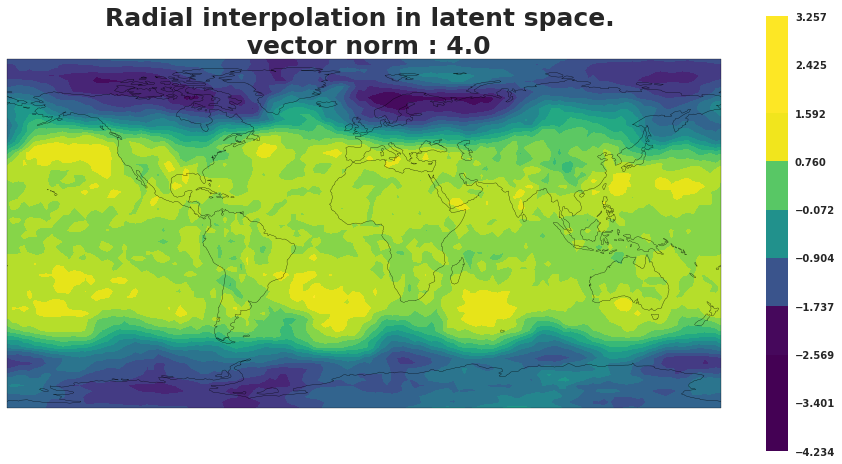

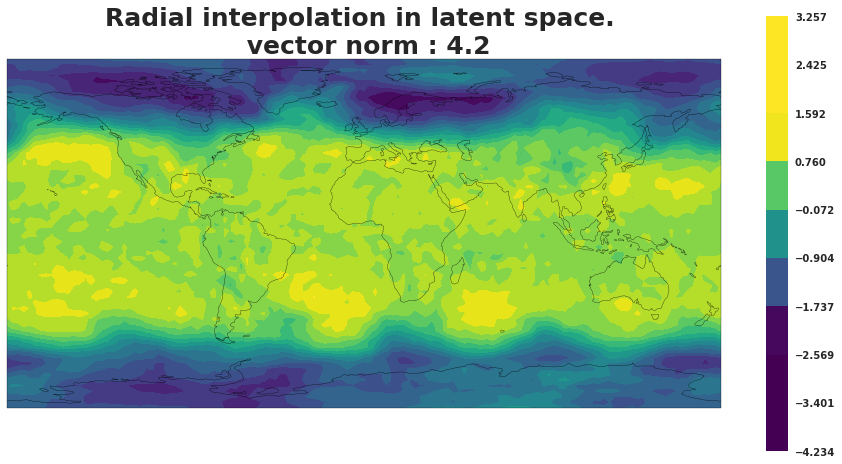

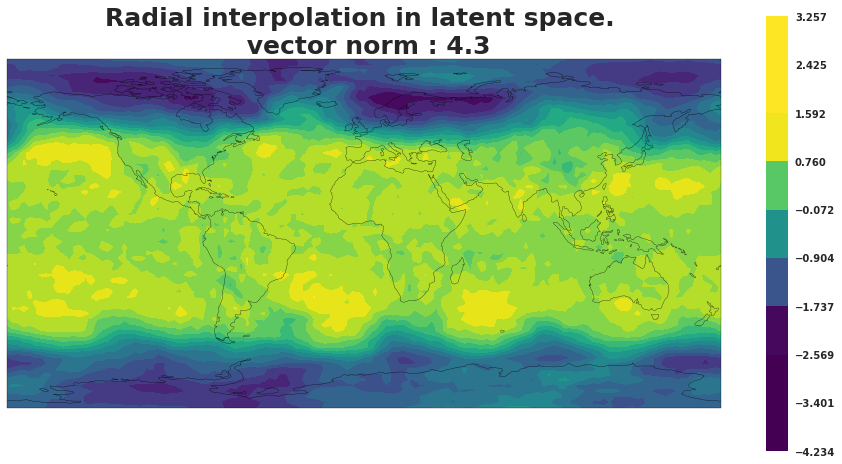

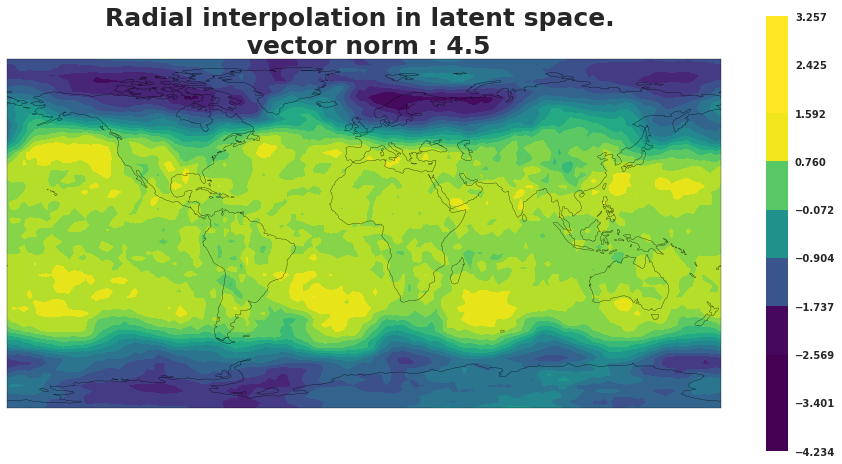

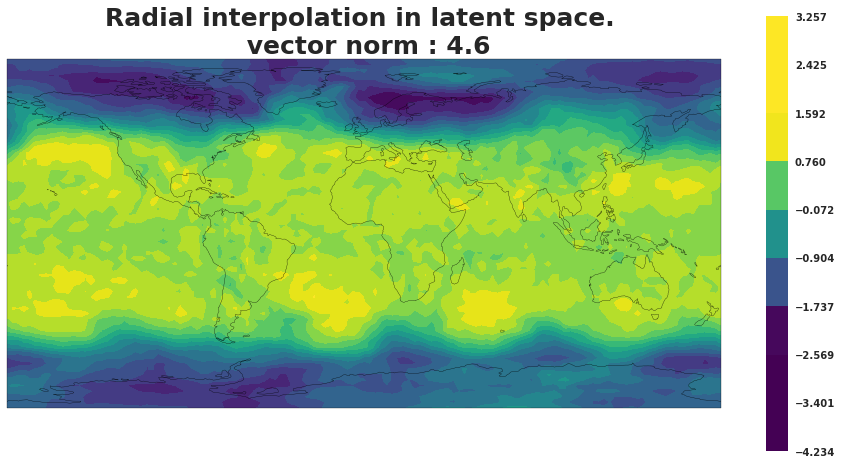

...

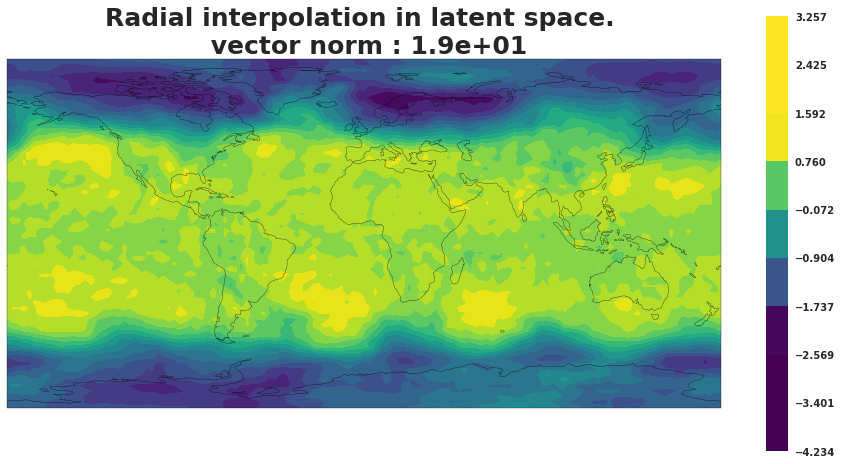

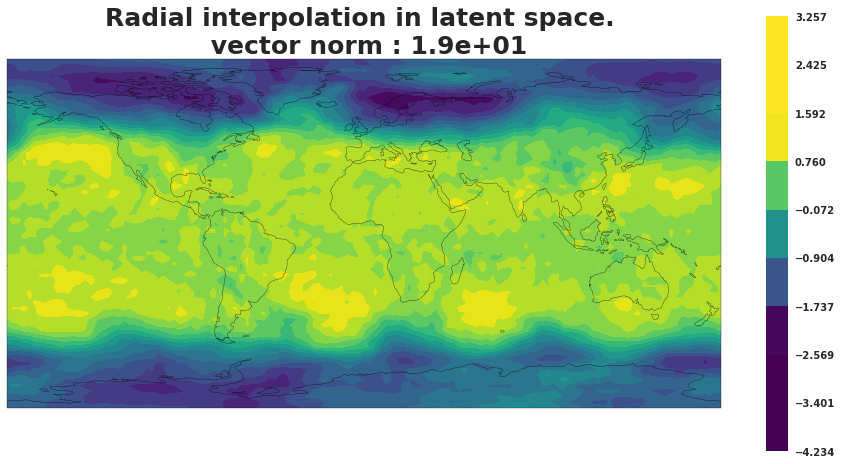

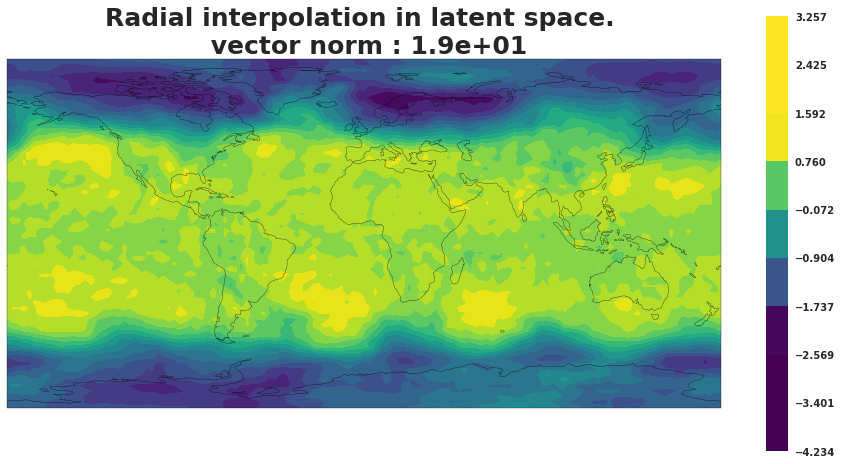

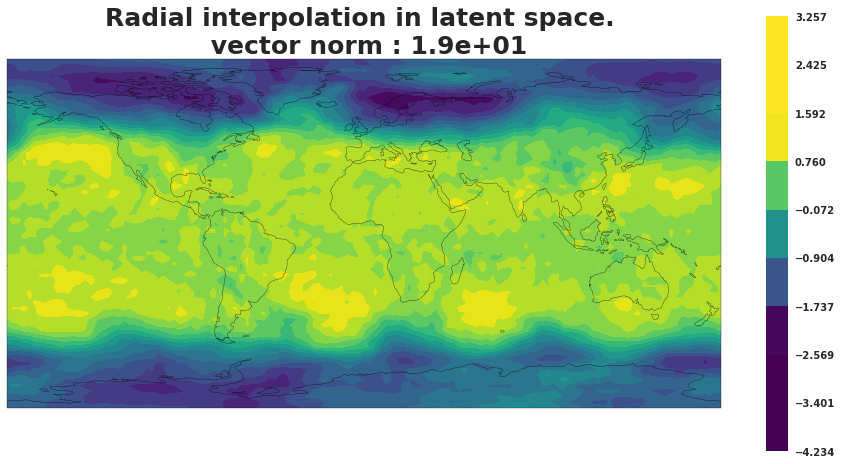

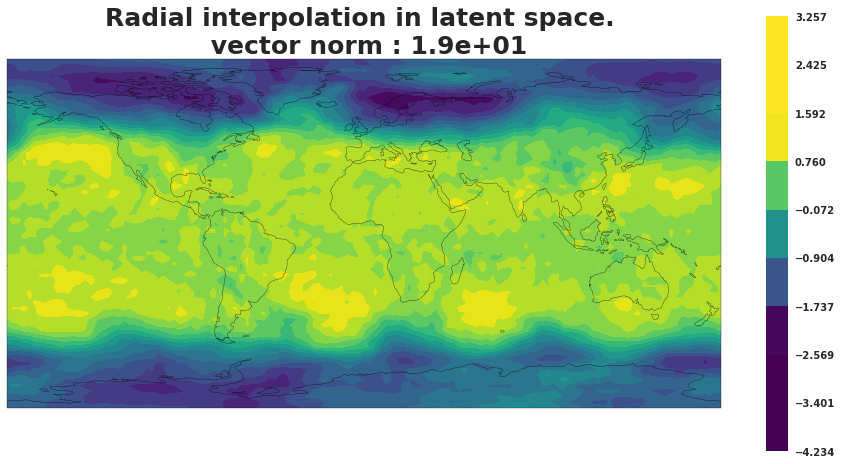

In [43]:
create_animation(imgs_interp[:,:,:],rad_interp, 'frame', lon = lon, lat=lat)

## Spherical interpolation : 

In [44]:
def slerp(val, low=None, high=None):
    """Spherical interpolation. val has a range of 0 to 1."""
    #low=low.reshape(low.shape[0])
    #high=high.reshape(high.shape[0])
    if val <= 0:
        return np.transpose(low)
    elif val >= 1:
        return high
    elif np.allclose(low, high):
        return low
    omega = np.arccos(np.dot(low/np.linalg.norm(low), high/np.linalg.norm(high)))
    so = np.sin(omega)
    return np.sin((1.0-val)*omega) / so * low + np.sin(val*omega)/so * high   



In [45]:
frames = 100
s_interp = np.zeros((frames,64))
noise1 = noise_
noise2 = noise2_

for i in range(frames):
    #s_interp[i,:] = slerp(1./frames*(i),np.transpose(rad_interp[0,:]),rad_interp[-1,:])
    s_interp[i,:] = slerp(1./frames*(i),np.transpose(noise1[0,:]), noise2[0,:])

    
print(s_interp)



[[-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 ...
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]]


In [46]:
imgs_interp = gen.predict(s_interp)[:,:,:,var2plot]
print(imgs_interp.shape)

(100, 64, 128)


In [47]:

import cartopy.util
#lons=lon
imgs_interp, lon = cartopy.util.add_cyclic_point(imgs_interp, coord=lons, axis=2)

[-4.23355198 -3.40127112 -2.56899026 -1.7367094  -0.90442854 -0.07214767
  0.76013319  1.59241405  2.42469491  3.25697577]
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 

/softs/anaconda3/envs/tf1.12-cuda10-py36/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 

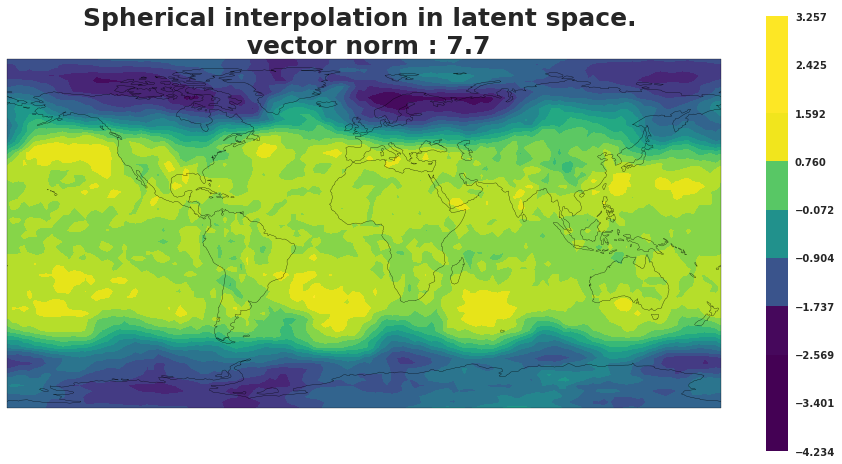

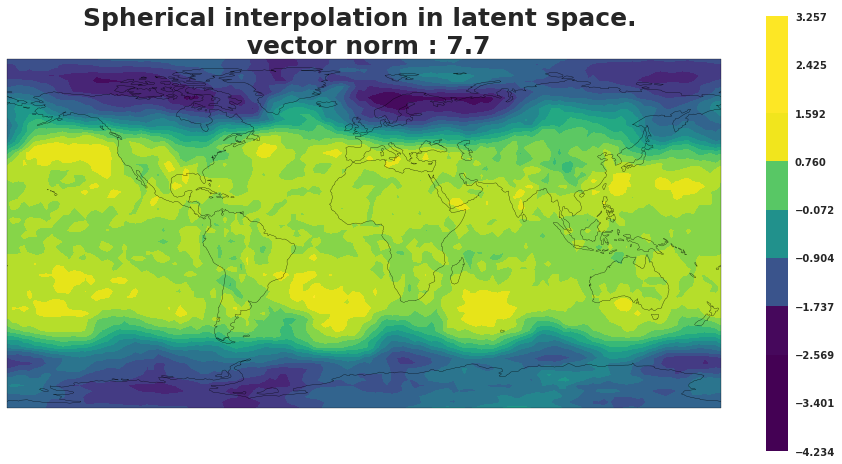

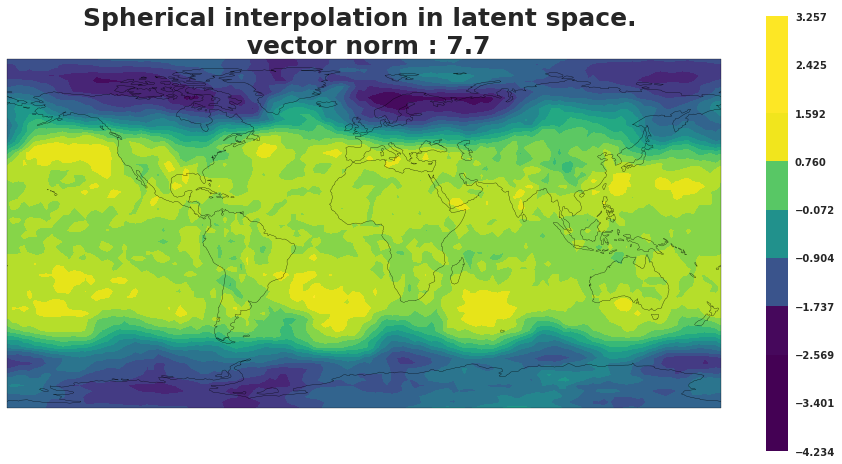

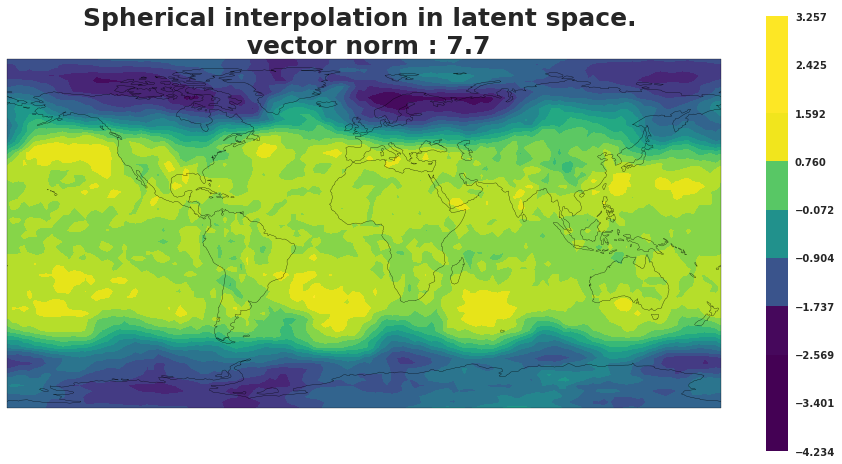

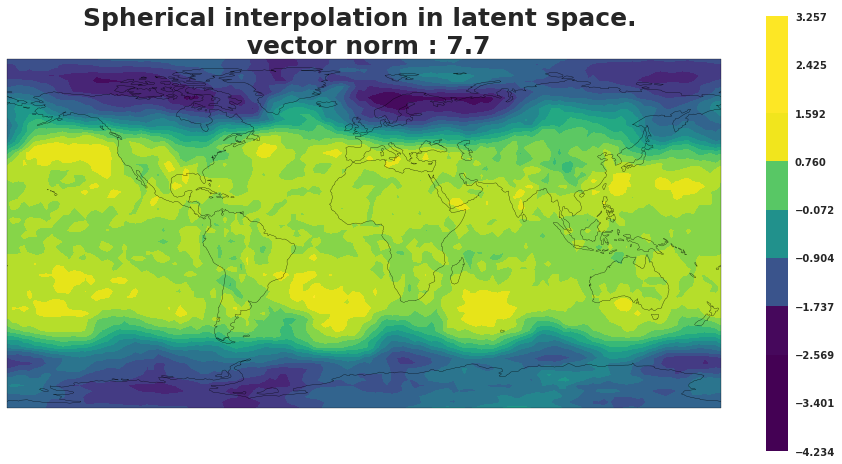

...

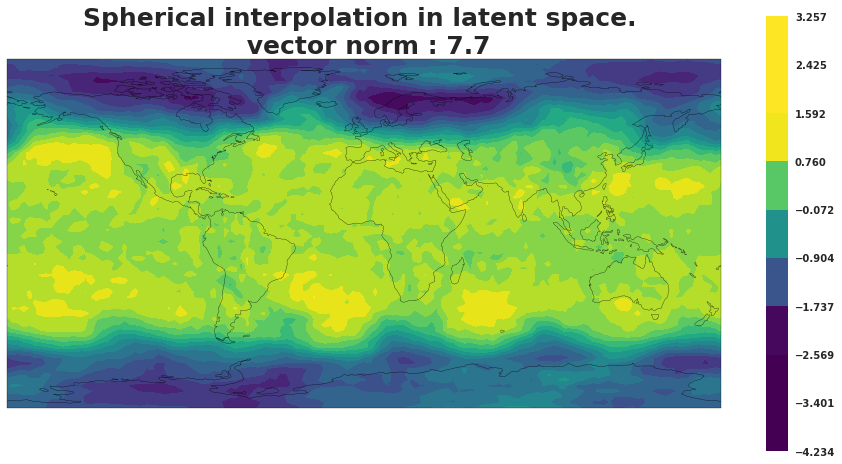

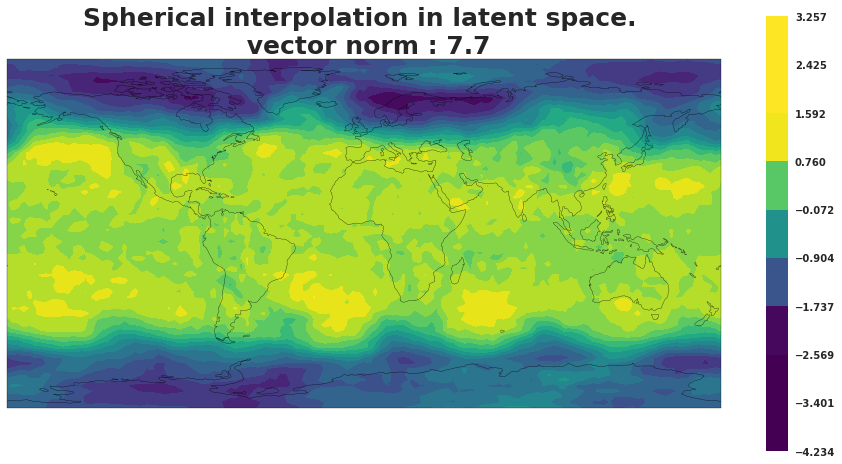

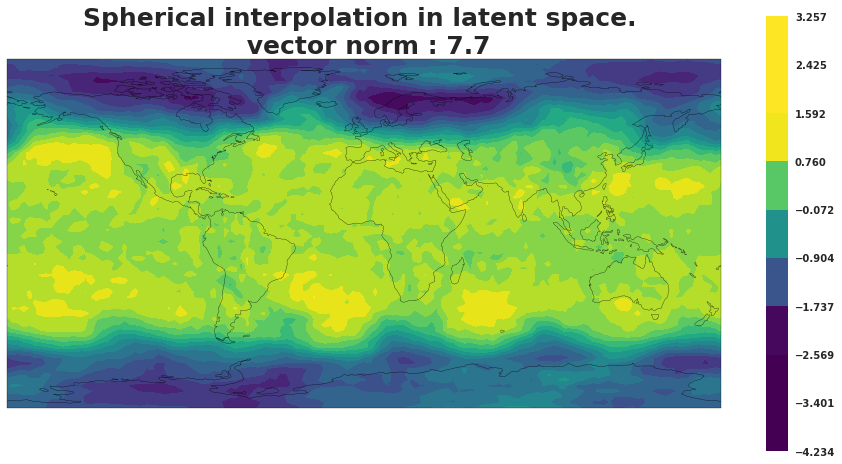

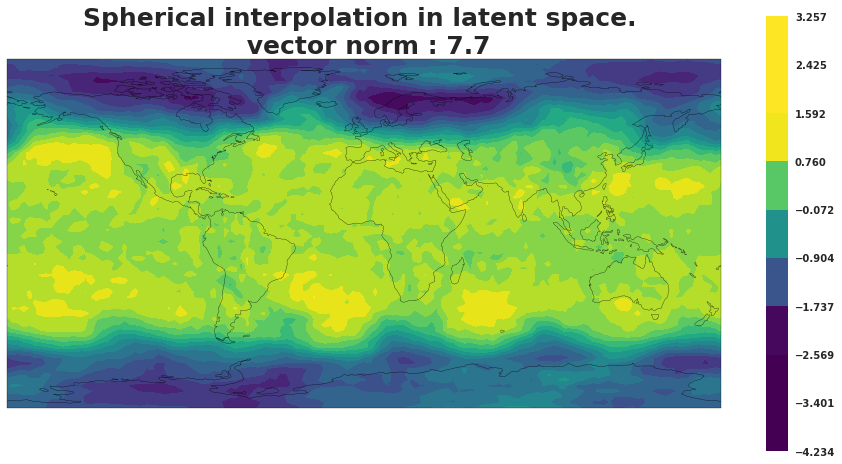

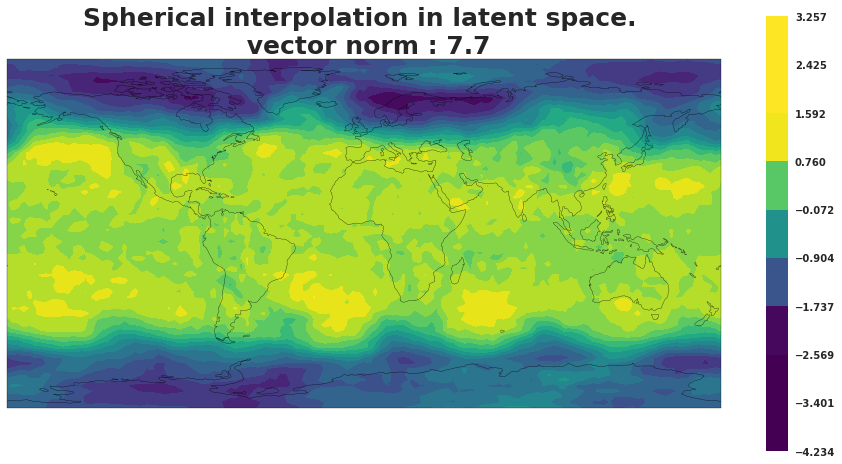

In [48]:
create_animation(imgs_interp, s_interp, 'frame_slerp', interp = 'Spherical', lon = lon, lat = lat)

In [49]:

imgs_interp_sc = np.multiply(imgs_interp[::-1,:,:],
                    scaling[np.newaxis,-1,1]) + scaling[np.newaxis,-1,0]

#imgs_interp_sc = imgs_interp


(1, 6)
0 1 2 3 4 5 

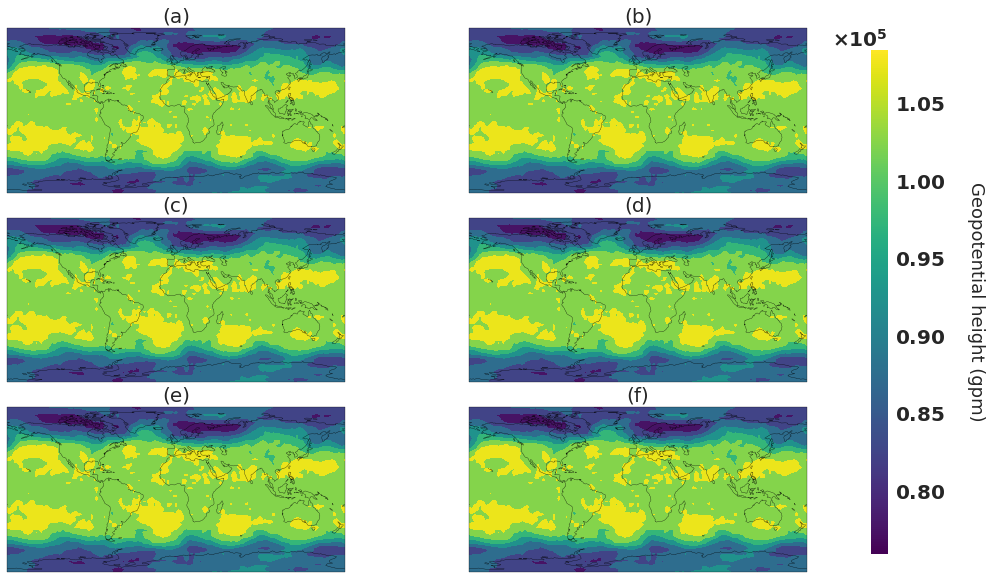

In [50]:
import matplotlib.ticker


fig, ax = plt.subplots(3,2, figsize=(15,10),
                    subplot_kw={'projection': ccrs.PlateCarree(central_longitude = 0.)})

fig.subplots_adjust(left = 0., right = 0.8, wspace = 0.15, hspace = 0.15)
#plt.suptitle(title, fontweight = fontweight)
ax = ax.reshape(1,-1)
print(ax.shape)

vmin = np.amin(imgs_interp_sc[::20,:,:], axis = (0,1,2))
vmax = np.amax(imgs_interp_sc[::20,:,:], axis = (0,1,2))

cticks = np.linspace(vmin, vmax, 10)

for i in range(6):
    if i==0:
        lvls = None
    else:
        lvls = ims.levels
    print(i,end=' ')
    plt.axis('off')

    ax[0,i].coastlines()
    ims = ax[0,i].contourf(lon, lat, imgs_interp_sc[i*19,:,:], cmap=cm.viridis, levels = lvls,
                     vmin = vmin, vmax = vmax, transform = ccrs.PlateCarree(central_longitude=360.))
    ax[0,i].set_title(f'({alph[i]})', fontsize = 20)
m = plt.cm.ScalarMappable(cmap=cm.viridis)
m.set_array(imgs_interp_sc[::19,:,:])
#m.set_clim(vmin, vmax)
fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.83, 0.15, 0.015, 0.7])
#cbar = fig.colorbar(m, boundaries=cticks, cax = cbar_ax)
cbar = fig.colorbar(m, cax = cbar_ax)
b = cbar_ax.set_ylabel('Geopotential height (gpm)', rotation=270, fontsize = 18, labelpad=40)
cbar_ax.tick_params(labelsize = 20)

cbar_ax.ticklabel_format( axis='y', style='sci',scilimits=(0,0), useOffset=False, useMathText=True)
cbar_ax.yaxis.get_offset_text().set_fontsize(20)

#plt.savefig(f'./fig_82c/snapshots6_slerp.pdf')

## Linear interpolation : 

In [51]:
def linterp(val, low=None, high=None):
    """Linear interpolation. val has a range of 0 to 1."""
    return val * low + (1-val)*high

In [52]:
frames = 100
lin_interp = np.zeros((frames,64))


for i in range(frames):
    #s_interp[i,:] = slerp(1./frames*(i),np.transpose(rad_interp[0,:]),rad_interp[-1,:])
    lin_interp[i,:] = linterp(1./frames*(i),noise1[0,:], noise2[0,:])

print(s_interp)

[[-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 ...
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]]


In [53]:
imgs_interp = gen.predict(lin_interp)[:,:,:,var2plot]
print(imgs_interp.shape)

(100, 64, 128)


In [54]:
imgs_interp, lon = cartopy.util.add_cyclic_point(imgs_interp, coord=lons, axis=2)

[-4.23355198 -3.4012712  -2.56899042 -1.73670963 -0.90442885 -0.07214807
  0.76013271  1.59241349  2.42469427  3.25697505]
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 

/softs/anaconda3/envs/tf1.12-cuda10-py36/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 

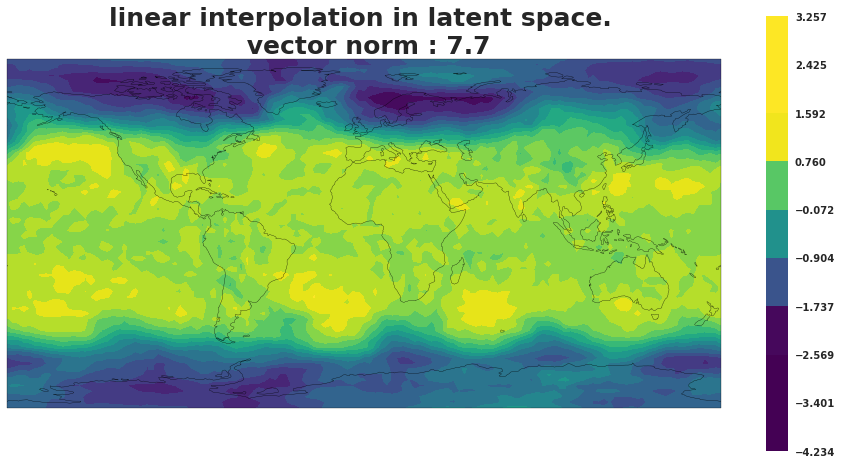

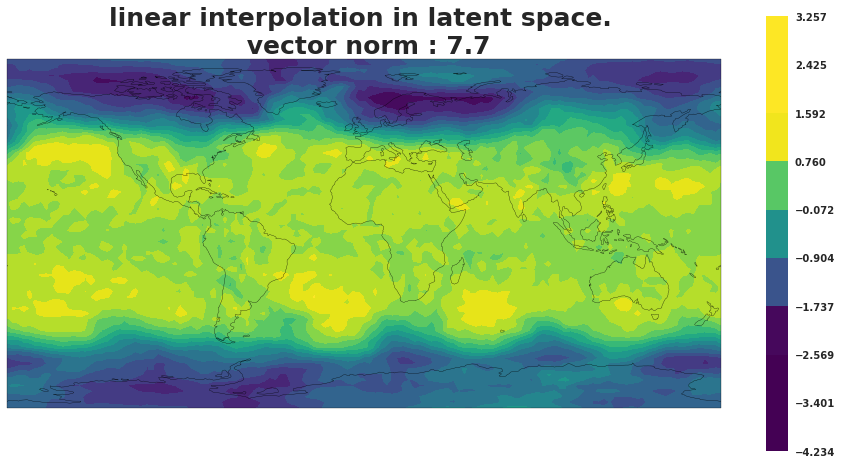

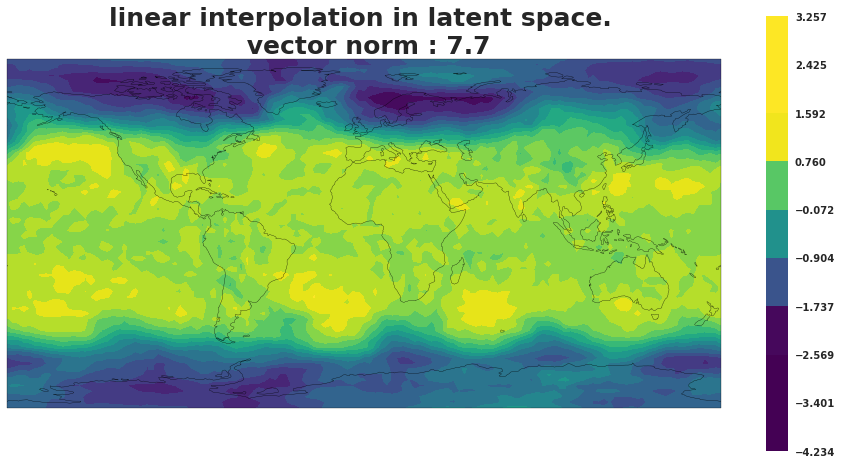

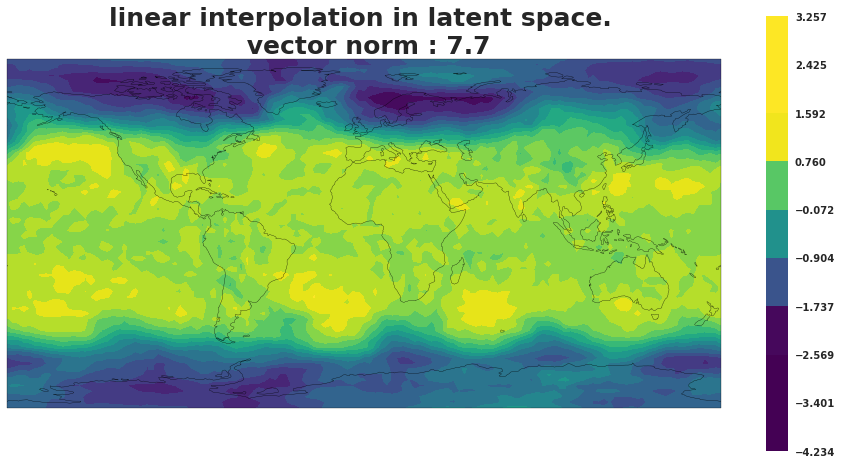

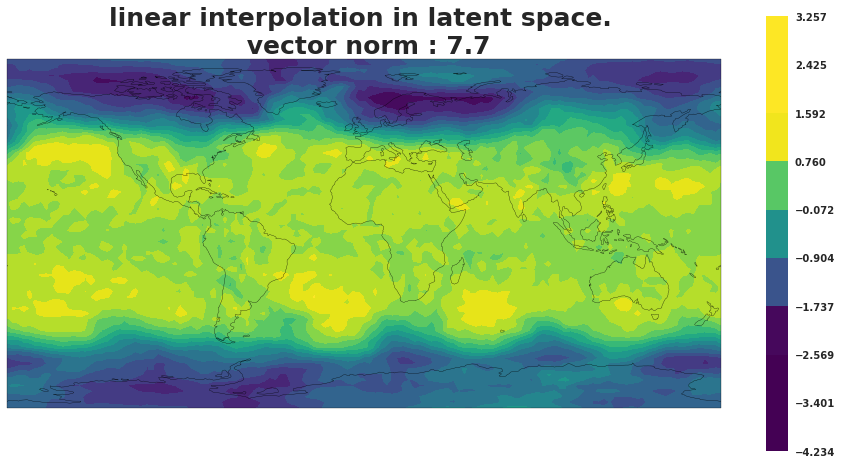

...

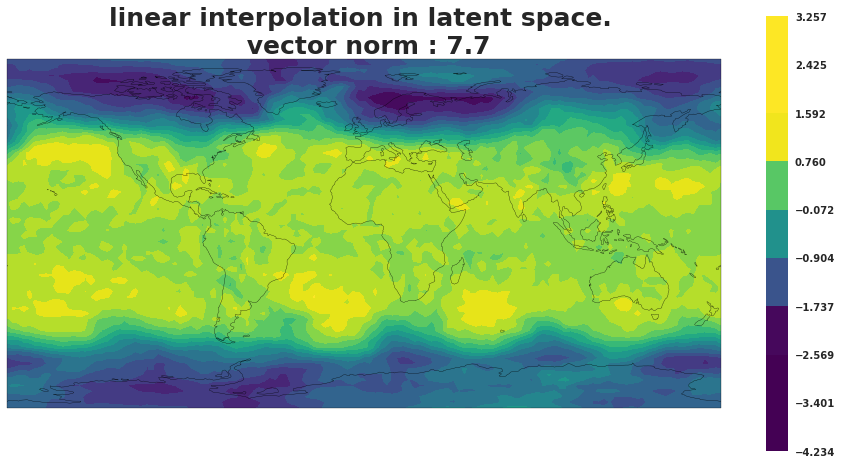

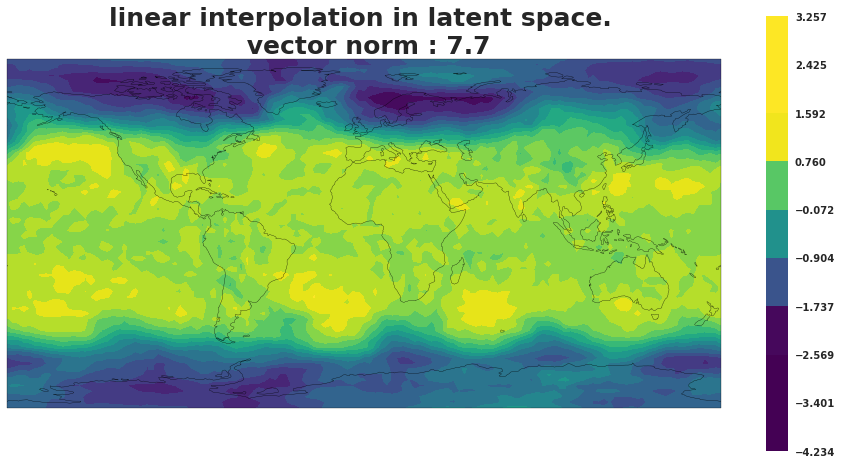

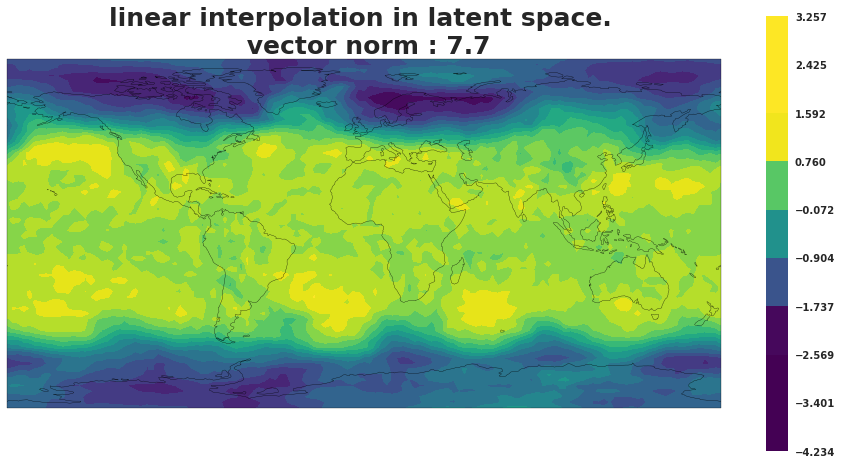

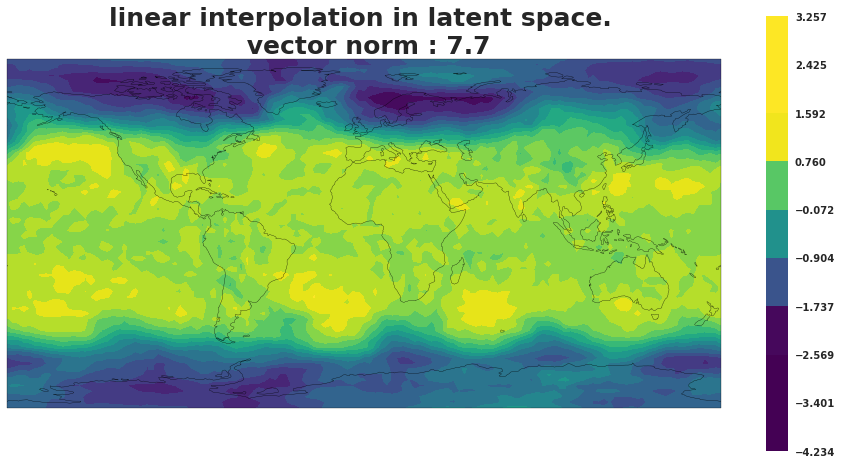

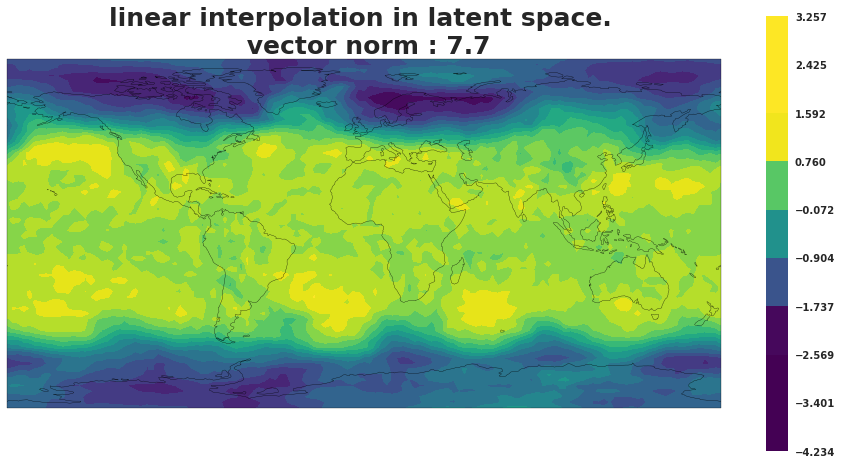

In [55]:
create_animation(imgs_interp, s_interp, 'frame_linerp', interp = 'linear', lon = lon, lat = lat)

In [56]:
imgs_interp_sc = np.multiply(imgs_interp[:,:,:],
                    scaling[np.newaxis,-1,1]) + scaling[np.newaxis,-1,0]

#imgs_interp_sc = imgs_interp


(1, 6)
0 1 2 3 4 5 

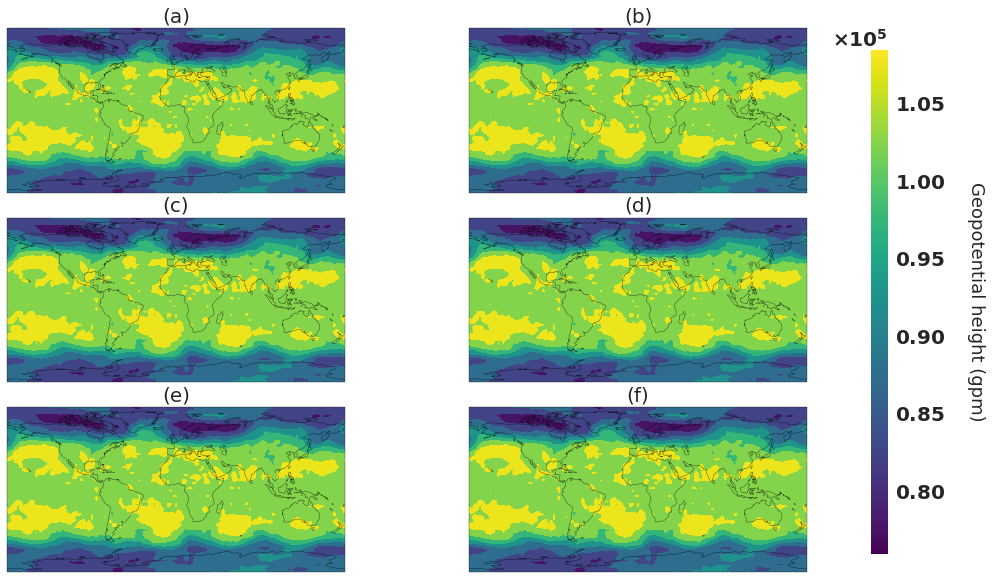

In [57]:
import matplotlib.ticker


fig, ax = plt.subplots(3,2, figsize=(15,10),
                    subplot_kw={'projection': ccrs.PlateCarree(central_longitude = 0.)})

fig.subplots_adjust(left = 0., right = 0.8, wspace = 0.15, hspace = 0.15)
#plt.suptitle(title, fontweight = fontweight)
ax = ax.reshape(1,-1)
print(ax.shape)

vmin = np.amin(imgs_interp_sc[::20,:,:], axis = (0,1,2))
vmax = np.amax(imgs_interp_sc[::20,:,:], axis = (0,1,2))

cticks = np.linspace(vmin, vmax, 10)

for i in range(6):
    print(i,end=' ')
    plt.axis('off')

    ax[0,i].coastlines()
    ax[0,i].contourf(lon, lat, imgs_interp_sc[i*19,:,:], cmap=cm.viridis, levels = ims.levels,
                     vmin = vmin, vmax = vmax, transform = ccrs.PlateCarree(central_longitude=360.))
    ax[0,i].set_title(f'({alph[i]})', fontsize = 20)
m = plt.cm.ScalarMappable(cmap=cm.viridis)
m.set_array(imgs_interp_sc[::19,:,:])
#m.set_clim(vmin, vmax)
fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.83, 0.15, 0.015, 0.7])
#cbar = fig.colorbar(m, boundaries=cticks, cax = cbar_ax)
cbar = fig.colorbar(m, cax = cbar_ax)
b = cbar_ax.set_ylabel('Geopotential height (gpm)', rotation=270, fontsize = 18, labelpad=40)
cbar_ax.tick_params(labelsize = 20)

cbar_ax.ticklabel_format( axis='y', style='sci',scilimits=(0,0), useOffset=False, useMathText=True)
cbar_ax.yaxis.get_offset_text().set_fontsize(20)

#plt.savefig(f'./fig_82c/snapshots6_linterp.pdf')

## Linear interpolation in image space : 

In [58]:
frames = 100
lin_interp = np.zeros((frames,64,129))


for i in range(frames):
    #s_interp[i,:] = slerp(1./frames*(i),np.transpose(rad_interp[0,:]),rad_interp[-1,:])
    lin_interp[i,:,:] = 1./frames*(i)*imgs_interp[0,:,:] + (1-1./frames*(i))*imgs_interp[-1,:,:]

print(s_interp)


[[-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 ...
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]
 [-1.18729576 -2.15289828  0.49010971 ...  1.11344806  0.34135586
  -0.43925957]]


In [59]:
def create_animation2(arr, output, folder = './animation/', interp = '', lon = None, lat=None):
    vmin = np.amin(arr)
    vmax = np.amax(arr)
    cticks = np.linspace(vmin-2, vmax+2, 10)
    print(cticks)
    plt.figure(figsize=(16,8))
    plt.axis('off')
    plt.title(f'{interp}.', fontsize = 25, fontweight = 'bold')
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
    ax.coastlines()
    plt.contourf(lon, lat, arr[0,:,:], cmap=cm.viridis, vmin = vmin, vmax = vmax,
                 levels=15, transform = ccrs.PlateCarree(central_longitude=360.))
    m = plt.cm.ScalarMappable(cmap=cm.viridis)
    m.set_array(arr)
    m.set_clim(vmin, vmax)
    plt.colorbar(m, boundaries=cticks)
    #plt.savefig(folder+'frame_xlin_{:04d}.png'.format(0), dpi = 100, optimize = True)
    plt.close()
    for i in range(1,arr.shape[0]):
        print(i,end=' ')
        plt.figure(figsize=(16,8))
        plt.axis('off')
        ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=0.))
        ax.coastlines()
        plt.title(f'{interp}.', fontsize = 25, fontweight = 'bold')
        plt.contourf(lon, lat, arr[i,:,:], cmap=cm.viridis, vmin = vmin, vmax = vmax,
                     levels=15, transform = ccrs.PlateCarree(central_longitude=360.))
        m = plt.cm.ScalarMappable(cmap=cm.viridis)
        m.set_array(arr)
        m.set_clim(vmin, vmax)
        plt.colorbar(m, boundaries=cticks)
        #plt.savefig(folder+'frame_xlin_{:04d}.png'.format(i), dpi = 100)
        #plt.close()
    return 


[-4.23355055 -3.40126993 -2.5689893  -1.73670868 -0.90442806 -0.07214744
  0.76013319  1.59241381  2.42469443  3.25697505]
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 

/softs/anaconda3/envs/tf1.12-cuda10-py36/lib/python3.6/site-packages/ipykernel_launcher.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 

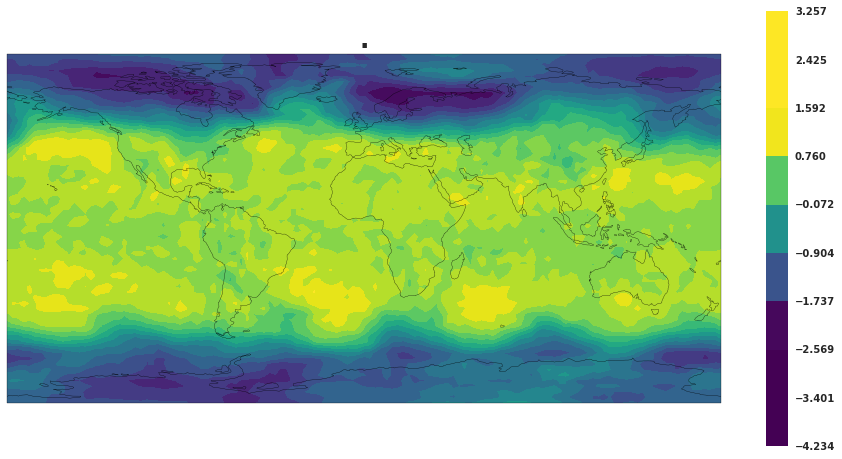

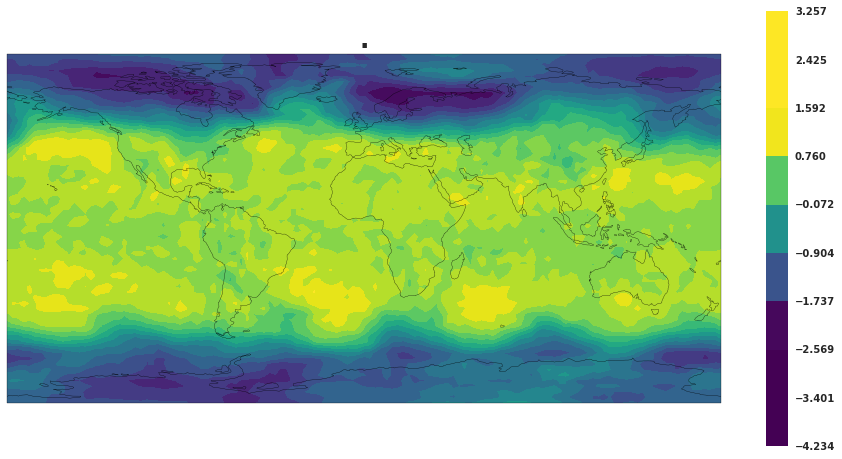

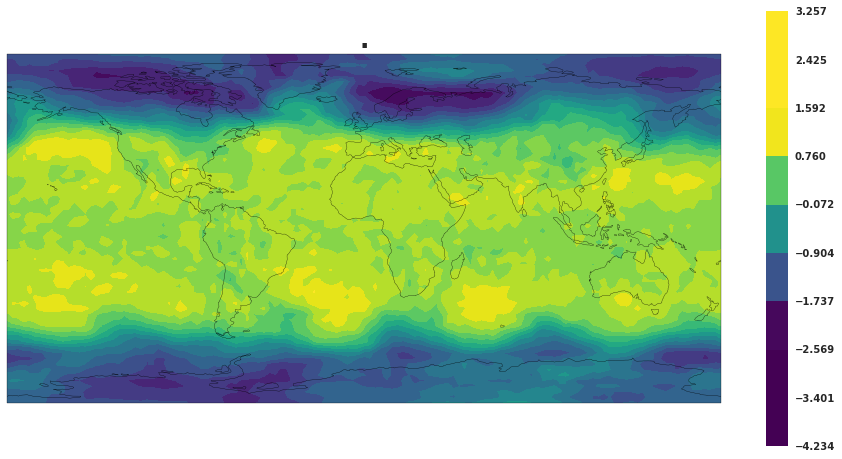

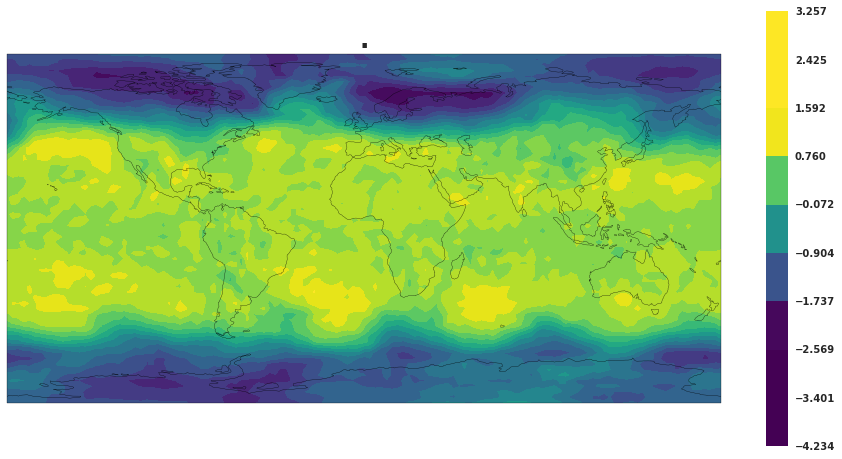

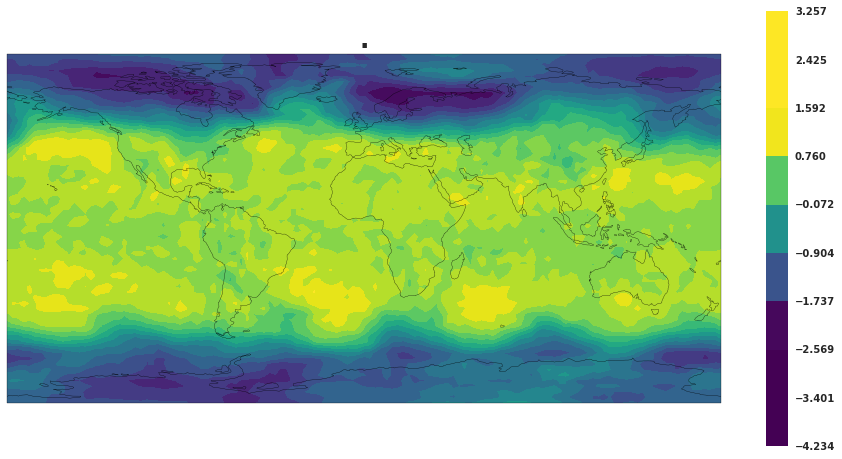

...

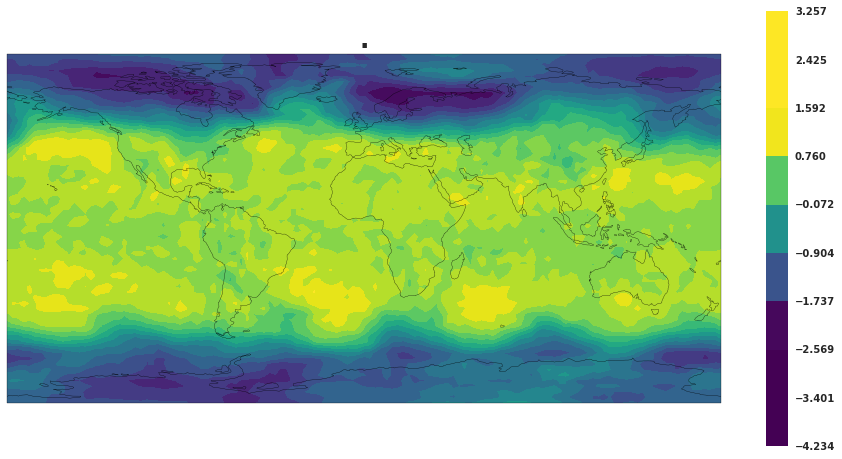

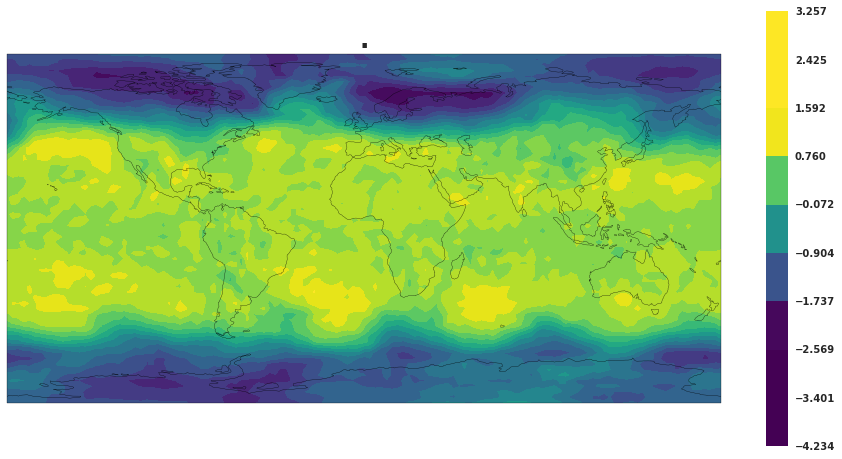

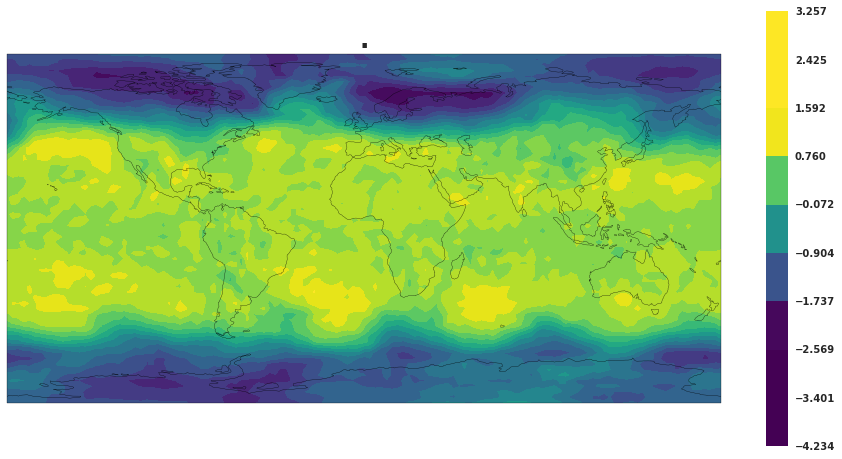

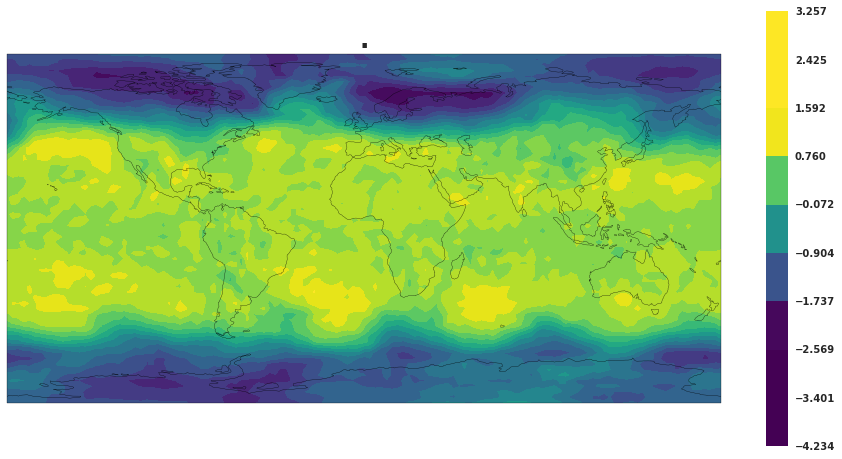

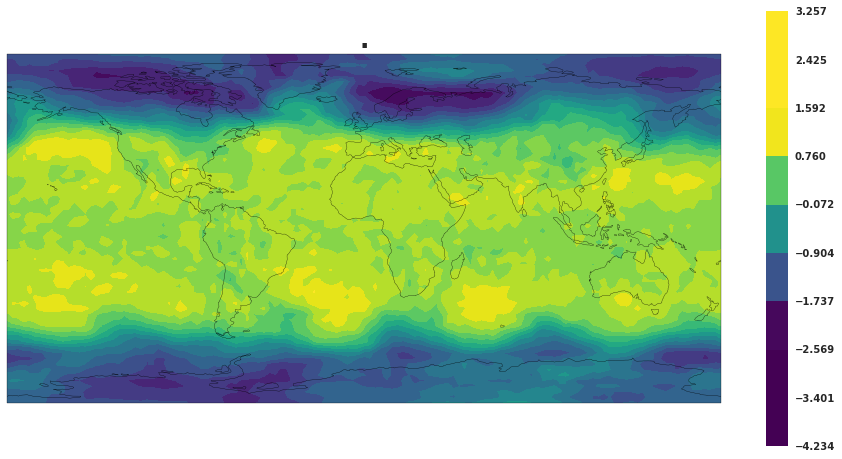

In [ ]:
create_animation2(lin_interp[::-1,:,:], s_interp, interp = '', lon = lon, lat = lat)

In [ ]:
imgs_interp = lin_interp[::-1,:,:]

In [ ]:
imgs_interp_sc = np.multiply(imgs_interp[:,:,:],
                    scaling[np.newaxis,-1,1]) + scaling[np.newaxis,-1,0]

In [ ]:
import matplotlib.ticker


fig, ax = plt.subplots(3,2, figsize=(15,10),
                    subplot_kw={'projection': ccrs.PlateCarree(central_longitude = 0.)})

fig.subplots_adjust(left = 0., right = 0.8, wspace = 0.15, hspace = 0.15)
#plt.suptitle(title, fontweight = fontweight)
ax = ax.reshape(1,-1)
print(ax.shape)

vmin = np.amin(imgs_interp_sc[::20,:,:], axis = (0,1,2))
vmax = np.amax(imgs_interp_sc[::20,:,:], axis = (0,1,2))

cticks = np.linspace(vmin, vmax, 10)

for i in range(6):
    print(i,end=' ')
    plt.axis('off')

    ax[0,i].coastlines()
    ax[0,i].contourf(lon, lat, imgs_interp_sc[i*19,:,:], cmap=cm.viridis, levels = ims.levels,
                     vmin = vmin, vmax = vmax, transform = ccrs.PlateCarree(central_longitude=360.))
    ax[0,i].set_title(f'({alph[i]})', fontsize = 20)
m = plt.cm.ScalarMappable(cmap=cm.viridis)
m.set_array(imgs_interp_sc[::19,:,:])
#m.set_clim(vmin, vmax)
fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.83, 0.15, 0.015, 0.7])
#cbar = fig.colorbar(m, boundaries=cticks, cax = cbar_ax)
cbar = fig.colorbar(m, cax = cbar_ax)
b = cbar_ax.set_ylabel('Geopotential height (gpm)', rotation=270, fontsize = 18, labelpad=40)
cbar_ax.tick_params(labelsize = 20)

cbar_ax.ticklabel_format( axis='y', style='sci',scilimits=(0,0), useOffset=False, useMathText=True)
cbar_ax.yaxis.get_offset_text().set_fontsize(20)

#plt.savefig(f'./fig_82c/snapshots6_xlinterp.pdf')